In [8]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

df = pd.read_csv('../raw_data/training_data.csv', index_col = [0])

# Cleaning

In [9]:
from scipy import stats

def remove_outliers(df, pctile_remove = 0.7, columns_list = []):
    
    df_cleaned = df.copy()

    threshold = 1 - (pctile_remove / 100)
    
    for col in columns_list:
        df_cleaned = df_cleaned[(df_cleaned[col] < df_cleaned[col].quantile(threshold))]

    print(f'the percentage of outliers disgarded is {1-len(df_cleaned)/len(df)}')
    
    return df_cleaned


In [10]:
cols_w_outliers = ['num_subs',
                   'docPerYear',
                   'docOnAusmedPerYear',
                   'numQueuedPerYear',
                   'minQueuedPerYear',
                   'GoalsPerYear',
                   'minPerYear', 
                   'minOnAusmedPerYear',
                   'minCompletedOnelinePerYear',
                   'doc_in_activation',
                   'subscribe_days']

df_clean = remove_outliers(df, pctile_remove = 0.8, columns_list = cols_w_outliers)


#get rid of people not subscribed for atleast a month
df_clean = df_clean[df_clean['subscribe_days'] > 30]

the percentage of outliers disgarded is 0.09502806736166802


# Feature Processing

### numerical processing

In [11]:
# keeping on numerical columns
# i will use the graphs of these to decide how to process them

df_num = df_clean.select_dtypes(include = ['float64', 'int64'])

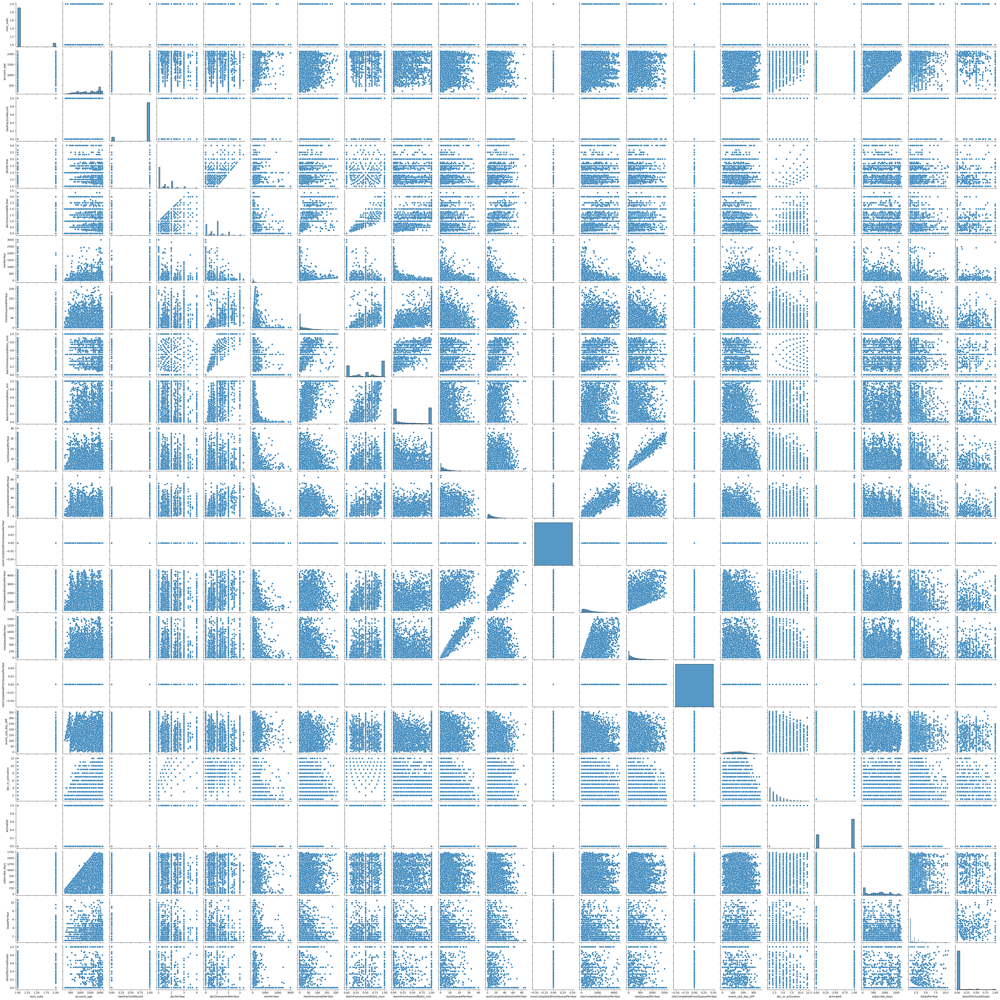

In [12]:
# slow! ~5 mins
# plot all the numerical features
# this is pretty much how I decided which processors to use

sns.pairplot(df_num)

In [13]:
# assign numerical columns to their respective pipeline selectors: minmax, log, standardscaler

# seem to have one unique value so exclude
exclude_cols = ['numCompletedFromQueuePerYear', 
                'minCompletedFromQueuePerYear']

# minmax beacause they have a finite range between 0-1 etc
minmax_cols = ['num_subs', 
               'activated', 
               'hasPracticeRecord', 
               'learnFromAusmedRatio_num', 
               'learnFromAusmedRatio_min', 
               'ratioOfAchivedGoals'] # seem to be binary

# log because they are skewed
log_cols = ['minPerYear', 
            'minOnAusmedPerYear', 
            'numQueuedPerYear', 
            'numCompletedOnelinePerYear', 
            'minCompletedOnelinePerYear', 
            'minQueuedPerYear', 
            'doc_in_activation']

# put all the rest of the columns through the standard scaler
sscaler_cols = [col for col in df_num.columns if col not in exclude_cols + minmax_cols + log_cols]

### ordinal processing

In [14]:
# just copied all of this from you, nice work!!
ord_cols = ['located',
            'Status', 
            'access', 
            'plan_type']

In [15]:
from sklearn.preprocessing import StandardScaler, RobustScaler, OrdinalEncoder, OneHotEncoder, FunctionTransformer, MinMaxScaler
from sklearn.cluster import MiniBatchKMeans
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.compose import ColumnTransformer, make_column_transformer
from sklearn import set_config; set_config(display='diagram')
from sklearn.impute import SimpleImputer
from sklearn.decomposition import PCA
from sklearn.preprocessing import OrdinalEncoder

def get_ord_encoder():

    # select the ones with only a few unique values
#     ord_cols = cat_ord=['located', 'Status', 'access', 'plan_type']

    # order columns
    feature_1_sorted_values = ['remote area', 'other rural area', 'small rural centre', 'large rural centre', 'other metropolitan centre', 'metropolitan centre', 'capital city'] # 'located', need to check this 
    feature_2_sorted_values = ['canceled', 'incomplete_expired','past_due', 'trialing','active',]
    feature_3_sorted_values = ['never', 'sometimes', 'usually', 'always']
    feature_4_sorted_values = ['monthly', 'quarterly', 'annually']


    # create categories iteratively: the shape of categories has to be (n_feature,)
    categories_base=[
            feature_1_sorted_values,
            feature_2_sorted_values,
            feature_3_sorted_values,
            feature_4_sorted_values
        ]

    # not sure about this, probably helpful?
#     categories=[]
#     for col in cat_ord:
#         for values in categories_base:
#             if set(values).isdisjoint(set(df_cleaned[col])) == False:
#                 categories.append(values)

    ord_enc = OrdinalEncoder(
        categories=categories_base,
        handle_unknown="use_encoded_value",
        unknown_value=-1,
        encoded_missing_value=-1
    )
    
    return ord_enc

### Create Preprocessing Pipeline

In [16]:
# print out all columns to use
for feature_list, feature_type in zip((sscaler_cols, minmax_cols, log_cols, ord_cols), ('standard', 'minmax', 'log', 'ordinal')):
    print(f' \n--- {feature_type} ---')
    for feat in feature_list:
        print(feat)

 
--- standard ---
account_age
docPerYear
docOnAusmedPerYear
event_cpd_day_diff
subscribe_days
GoalsPerYear
 
--- minmax ---
num_subs
activated
hasPracticeRecord
learnFromAusmedRatio_num
learnFromAusmedRatio_min
ratioOfAchivedGoals
 
--- log ---
minPerYear
minOnAusmedPerYear
numQueuedPerYear
numCompletedOnelinePerYear
minCompletedOnelinePerYear
minQueuedPerYear
doc_in_activation
 
--- ordinal ---
located
Status
access
plan_type


In [17]:
def log_transform(x):
    return np.log(x + 1)

In [18]:
# standard scaler
sscaler_transformer = make_pipeline(SimpleImputer(strategy = 'median'),
                                StandardScaler())

# minmax scaler
minmax_transformer = make_pipeline(SimpleImputer(strategy = 'most_frequent'),
                                MinMaxScaler())

# log transform & scaler
log_transformer = make_pipeline(SimpleImputer(strategy = 'median'),
                                FunctionTransformer(log_transform),
                                RobustScaler())

# use the above ordinal encoder & minmax. all exist so no need for simple imputer?
ord_transformer = make_pipeline(get_ord_encoder(),
                                MinMaxScaler())

# combine all pipelines together, drop the unassigned columns
preproc = make_column_transformer((sscaler_transformer, sscaler_cols), 
                                  (minmax_transformer, minmax_cols),
                                  (log_transformer, log_cols),
                                  (ord_transformer, ord_cols),
                                  remainder='drop')

preproc

ColumnTransformer(transformers=[('pipeline-1',
                                 Pipeline(steps=[('simpleimputer',
                                                  SimpleImputer(strategy='median')),
                                                 ('standardscaler',
                                                  StandardScaler())]),
                                 ['account_age', 'docPerYear',
                                  'docOnAusmedPerYear', 'event_cpd_day_diff',
                                  'subscribe_days', 'GoalsPerYear']),
                                ('pipeline-2',
                                 Pipeline(steps=[('simpleimputer',
                                                  SimpleImputer(strategy='most_frequent')),
                                                 ('minma...
                                                                              'metropolitan '
                                                                              'centre',
                                                                              'metropolitan '
                                                                              'centre',
                                                                              'capital '
                                                                              'city'],
                                                                             ['canceled',
                                                                              'incomplete_expired',
                                                                              'past_due',
                                                                              'trialing',
                                                                              'active'],
                                                                             ['never',
                                                                              'sometimes',
                                                                              'usually',
                                                                              'always'],
                                                                             ['monthly',
                                                                              'quarterly',
                                                                              'annually']],
                                                                 encoded_missing_value=-1,
                                                                 handle_unknown='use_encoded_value',
                                                                 unknown_value=-1)),
                                                 ('minmaxscaler',
                                                  MinMaxScaler())]),
                                 ['located', 'Status', 'access', 'plan_type'])])

### use preprocessor

In [19]:
# add all columns to one list to make it easier
all_columns = sscaler_cols + minmax_cols + log_cols + ord_cols # + ['missing_indicator']

In [20]:
# process the dataframe and save back into dataframe
df_processed = pd.DataFrame(preproc.fit_transform(df_clean),
                            columns = all_columns)

In [21]:
df_processed.head()

,account_age,docPerYear,docOnAusmedPerYear,event_cpd_day_diff,subscribe_days,GoalsPerYear,num_subs,activated,hasPracticeRecord,learnFromAusmedRatio_num,...,minOnAusmedPerYear,numQueuedPerYear,numCompletedOnelinePerYear,minCompletedOnelinePerYear,minQueuedPerYear,doc_in_activation,located,Status,access,plan_type
0,1.142330,0.796603,1.330131,-1.115564,0.891850,-0.601023,1.0,1.0,1.0,0.875000,...,0.362646,-0.191918,1.058189,0.774850,-0.260827,1.198978,0.571429,0.0,1.00,0.0
1,1.148533,0.405049,0.619430,-0.911565,-1.383254,-0.601023,1.0,1.0,1.0,0.714286,...,0.247556,-0.058310,0.766528,0.469251,-0.030588,1.070435,0.857143,0.0,1.00,0.5
2,1.154737,-0.769614,0.264079,-1.487081,-0.215575,0.091994,1.0,1.0,1.0,1.000000,...,0.432041,1.152933,0.905642,1.067119,0.873575,0.313964,0.857143,0.0,0.75,0.5
3,0.997576,-0.378060,-0.091272,-0.091558,-1.354166,0.091994,1.0,1.0,1.0,0.600000,...,0.291752,0.201181,1.137538,0.956613,0.180130,0.756471,0.857143,0.0,0.50,0.5
4,1.092700,-0.769614,0.264079,1.597591,-0.595798,0.091994,1.0,0.0,1.0,1.000000,...,-0.258039,0.895777,-0.461372,0.085944,0.635198,-0.442507,0.857143,1.0,1.00,0.5


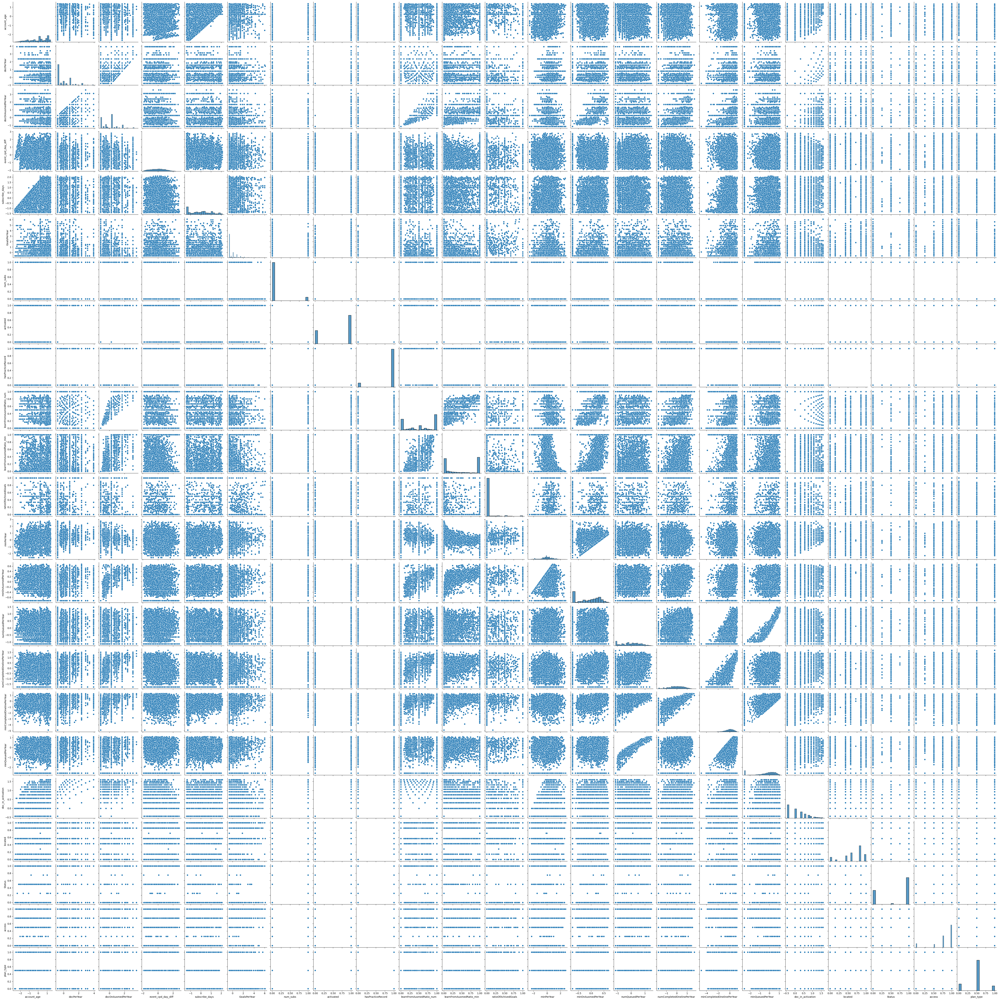

In [43]:
# slow! ~5mins
# replot all the features to check transformations

sns.pairplot(df_processed)

# PCA

In [44]:
def plot_pca_results(pca_results, num_pcs = None):
    
    # get explained variance of each PC
    explained_variance = pca_results.explained_variance_

    # plot explained variance for elbow plot
    plt.plot(explained_variance)
    plt.xlabel('# PCS')
    if num_pcs:
        plt.scatter(num_pcs, explained_variance[num_pcs], c = 'r');
    

### check best number of pcs

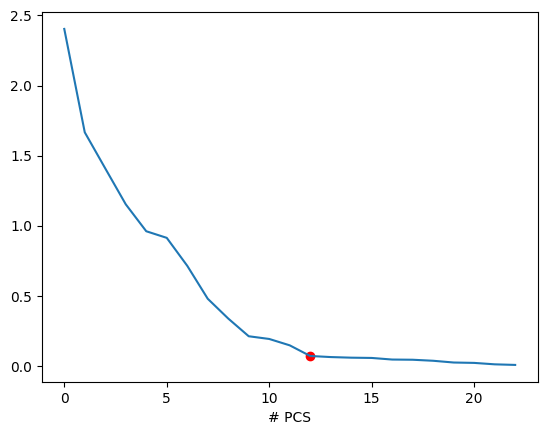

In [45]:
total_num_features = df_processed.shape[1]

pca_pipe = make_pipeline(preproc,
                         PCA(total_num_features))

# process the dataframe and save back into dataframe
pcs_plot_df = pd.DataFrame(pca_pipe.fit_transform(df_clean),
                           columns = [f'PC{i + 1}' for i in range(total_num_features)])

plot_pca_results(pca_results = pca_pipe[-1], 
                 num_pcs = 12)

# looks like ~12 pcs explain a good amount of the variation?
best_num_pcs = 12

# Cluster

### check best number of clusters

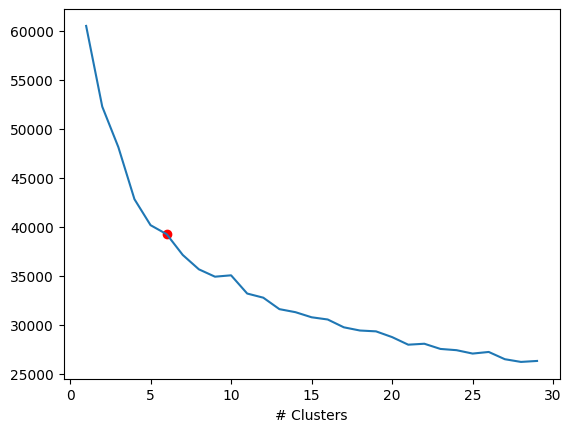

In [46]:
# find the optimal n_cluster with elbow method
# will change a little bit each time because of mini batches

inertia_list = []

clusters = list(range(1, 30))

for k in clusters:
    
    kmeans_elbow = make_pipeline(preproc, 
                                 PCA(best_num_pcs),
                                 MiniBatchKMeans(n_clusters = k)).fit(df_clean)
    
    inertia_list.append(kmeans_elbow[-1].inertia_)
    
plt.plot(clusters, inertia_list);
plt.xlabel('# Clusters')

n_clusters = 6
plt.scatter(n_clusters, inertia_list[n_clusters - 1], c = 'r');

# looks like ~4 to ~8 clusters is best? 
best_num_clusters = 6

## Full Pipeline

In [26]:
# create list of PC names
pc_columns = [f'PC{i + 1}' for i in range(best_num_pcs)]

# use best number of pcs to create a final pca pipe
best_pca_pipe = make_pipeline(preproc,
                          PCA(best_num_pcs))

# process the dataframe and save back into dataframe
pcs_df = pd.DataFrame(best_pca_pipe.fit_transform(df_clean),
                           columns = pc_columns)

# get fitted pca
fitted_pca = best_pca_pipe[-1]

pcs_df.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12
0,-2.150599,1.024758,0.651698,-1.653523,-0.426440,-0.088259,0.737210,0.505573,0.239142,-0.032849,0.043935,0.832646
1,-1.164872,0.631733,0.605608,0.066813,-1.724453,-0.326654,1.507734,0.722724,-0.133087,-0.348908,-0.364044,0.198990
2,-1.851154,0.513230,-1.664991,-0.515220,-1.194501,0.437888,1.230156,0.509039,-0.469530,-0.200864,-0.340001,0.452208
3,-0.860622,0.352624,-0.444910,0.613899,-1.074459,0.035063,1.456591,1.528416,0.074859,-0.044015,-0.512180,0.174532
4,0.066762,-1.342878,-1.425083,0.167346,1.557537,-0.252443,2.044098,-0.294016,0.329198,-0.147441,0.230480,-0.481513


In [27]:
# use best number of clusters to create a final kmeans pipe
full_pipe = make_pipeline(best_pca_pipe,
                          MiniBatchKMeans(best_num_clusters))

# fit pipeline
full_pipe.fit(df_clean);

# get fit kmeans
fitted_kmeans = full_pipe[-1]

# Visualise Clusters

## Size

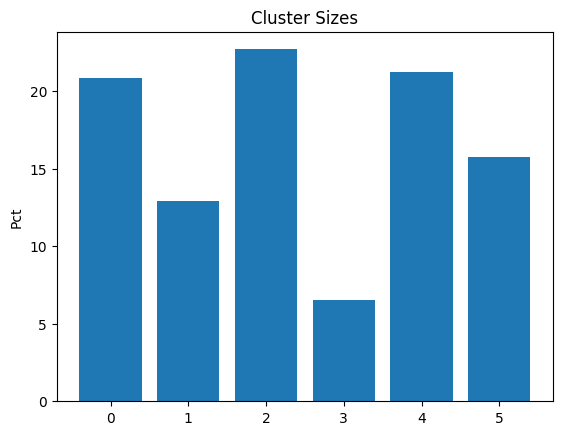

In [28]:
# check counts in each cluster
cluster_ids, cluster_counts = np.unique(fitted_kmeans.labels_, return_counts = True)

# plot counts
plt.bar(cluster_ids, cluster_counts / cluster_counts.sum() * 100)
plt.title('Cluster Sizes')
plt.ylabel('Pct');

## Principal Components (PCA)

In [29]:
# combine pca and kmeans results
pcs_df['cluster_id'] = fitted_kmeans.labels_

In [32]:
import plotly.express as px

# plot in 3d
fig = px.scatter_3d(pcs_df, x='PC1', y='PC2', z='PC3', color='cluster_id')
fig

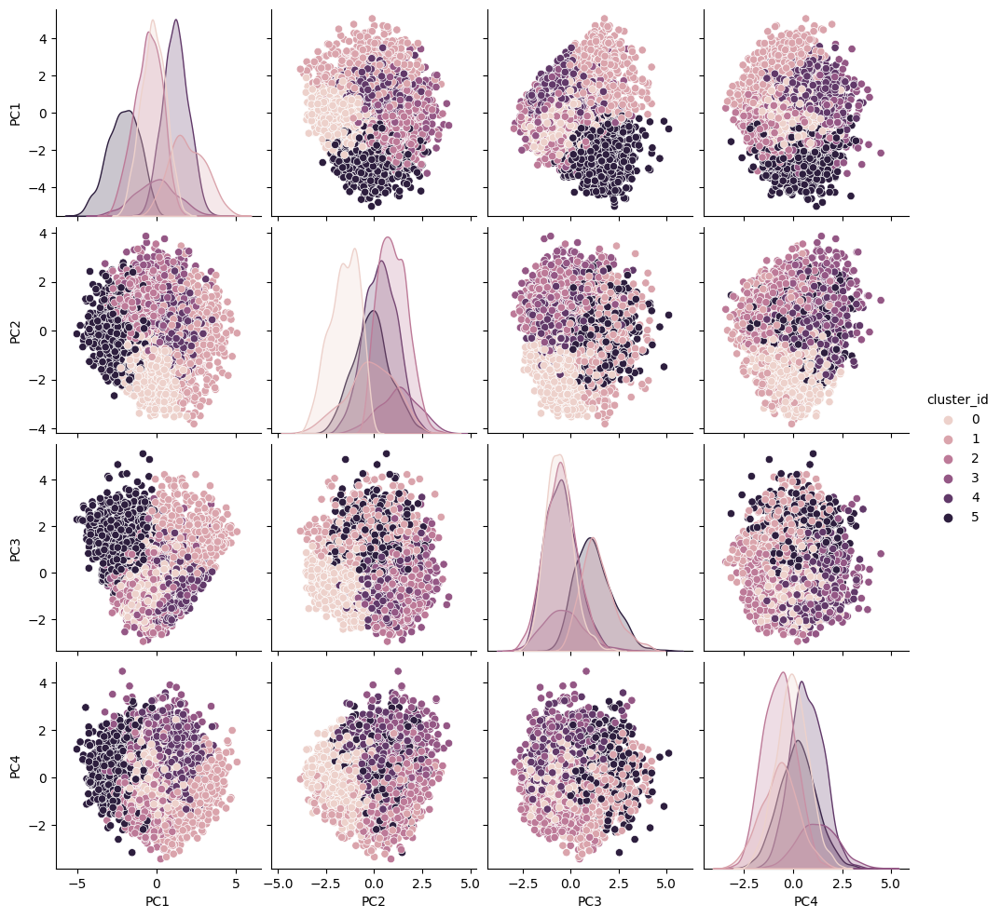

In [33]:
# visualise first 4 PCs in 2D
sns.pairplot(pcs_df[['PC1', 'PC2', 'PC3', 'PC4', 'cluster_id']], hue = 'cluster_id');

## Original Features

### Compare Centers

In [34]:
# reverse the PCA to get back to the original features
cluster_centers_processed = fitted_pca.inverse_transform(fitted_kmeans.cluster_centers_)

# convert from array back to original processed dataframe
cluster_centers_processed_df = pd.DataFrame(cluster_centers_processed,
                          columns = all_columns)

cluster_centers_processed_df.head(3)

,account_age,docPerYear,docOnAusmedPerYear,event_cpd_day_diff,subscribe_days,GoalsPerYear,num_subs,activated,hasPracticeRecord,learnFromAusmedRatio_num,...,minOnAusmedPerYear,numQueuedPerYear,numCompletedOnelinePerYear,minCompletedOnelinePerYear,minQueuedPerYear,doc_in_activation,located,Status,access,plan_type
0,-0.688140,-0.647280,0.293886,0.209747,-0.415202,-0.280619,0.092395,0.350518,0.862298,0.849299,...,-0.020848,0.219140,0.089048,0.067171,0.102199,-0.282707,0.631438,0.602761,0.741714,0.532941
1,0.126709,-0.230935,-0.311870,0.160680,-0.259761,-0.160525,0.052683,0.605416,0.867249,0.460947,...,-0.257523,-1.221272,-0.489098,-1.115235,-2.125519,0.070667,0.627629,0.658738,0.758352,0.457368
2,0.655201,0.052499,-0.048254,-0.420109,0.897055,-0.112642,0.086259,0.935668,0.933097,0.507579,...,-0.040647,0.158782,0.180721,0.223039,0.083618,0.497516,0.674015,0.819411,0.822931,0.409789


#### get the original features for each cluster (maybe not needed?)

In [35]:
# get back to df_clean features for each of the cluster centers, pretty specific & feels hackish haha

# reverse standard scaler
og_sscaler_data = best_pca_pipe[0].transformers_[0][1][1].inverse_transform(cluster_centers_processed_df[sscaler_cols])

# reverse minmax scaler
og_minmax_data = best_pca_pipe[0].transformers_[1][1][1].inverse_transform(cluster_centers_processed_df[minmax_cols])

# reverse robust scaler
og_log_data = best_pca_pipe[0].transformers_[2][1][1].inverse_transform(cluster_centers_processed_df[log_cols])

# reverse log
og_log_data = np.exp(og_log_data)

# reverse minmax & ordinal encoder
og_ord_data = best_pca_pipe[0].transformers_[3][1].inverse_transform(cluster_centers_processed_df[ord_cols])


# join the pieces of data back together
original_features_cluster_centers = pd.DataFrame(np.hstack([og_sscaler_data, og_minmax_data, og_log_data, og_ord_data]),
                                                columns = all_columns)

original_features_cluster_centers.head(1)

,account_age,docPerYear,docOnAusmedPerYear,event_cpd_day_diff,subscribe_days,GoalsPerYear,num_subs,activated,hasPracticeRecord,learnFromAusmedRatio_num,...,minOnAusmedPerYear,numQueuedPerYear,numCompletedOnelinePerYear,minCompletedOnelinePerYear,minQueuedPerYear,doc_in_activation,located,Status,access,plan_type
0,1129.819281,1.078108,1.02097,162.080702,513.920181,1.462331,1.092395,0.350518,0.862298,0.849299,...,0.979367,1.245006,1.093133,1.069478,1.107604,0.753741,large rural centre,past_due,sometimes,quarterly


#### most important features

In [36]:
# get threshold for top ten most helpful features
top_ten_threshold = cluster_centers_processed_df.std().sort_values(ascending = False)[10]

# maybe check correlation to remove some more?

# create an important columns list
important_columns = [col for col in cluster_centers_processed_df.columns if cluster_centers_processed_df[col].std() > top_ten_threshold]

# filter for helpful features
cluster_centers_top_feat = cluster_centers_processed_df.loc[:, important_columns]

cluster_centers_top_feat.head(3)


,account_age,docPerYear,docOnAusmedPerYear,subscribe_days,GoalsPerYear,minPerYear,numQueuedPerYear,numCompletedOnelinePerYear,minCompletedOnelinePerYear,minQueuedPerYear
0,-0.688140,-0.647280,0.293886,-0.415202,-0.280619,-0.823742,0.219140,0.089048,0.067171,0.102199
1,0.126709,-0.230935,-0.311870,-0.259761,-0.160525,-0.051377,-1.221272,-0.489098,-1.115235,-2.125519
2,0.655201,0.052499,-0.048254,0.897055,-0.112642,0.206519,0.158782,0.180721,0.223039,0.083618


In [37]:
# get each clusters difference (std deviation) from the mean
# they will be relative to each other and so easier to compare

from scipy import stats

def zscore_df(df):
    return df.apply(lambda col: stats.zscore(col))

df_interest = zscore_df(cluster_centers_top_feat)

#### look at each cluster

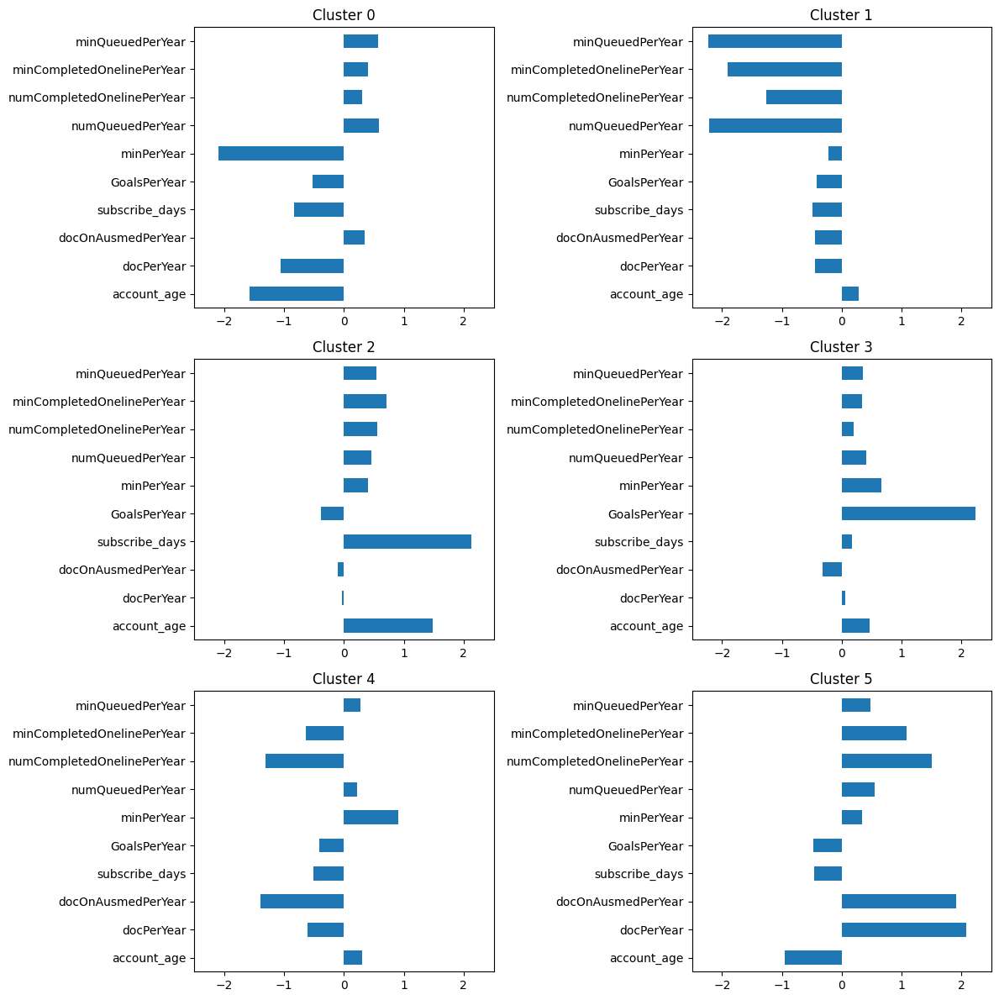

In [38]:
fig, axes = plt.subplots(3, 2, figsize = (12, 12))

for ax, cluster_id in zip(axes.flat, cluster_ids):
    df_interest.iloc[cluster_id, :].plot(kind = 'barh', ax = ax)
    ax.set_title(f'Cluster {cluster_id}')
    ax.set_xlim((-2.5, 2.5))
    
plt.tight_layout()

# plt.savefig('cluster_comparison.png', facecolor = 'white')

#### look at each feature

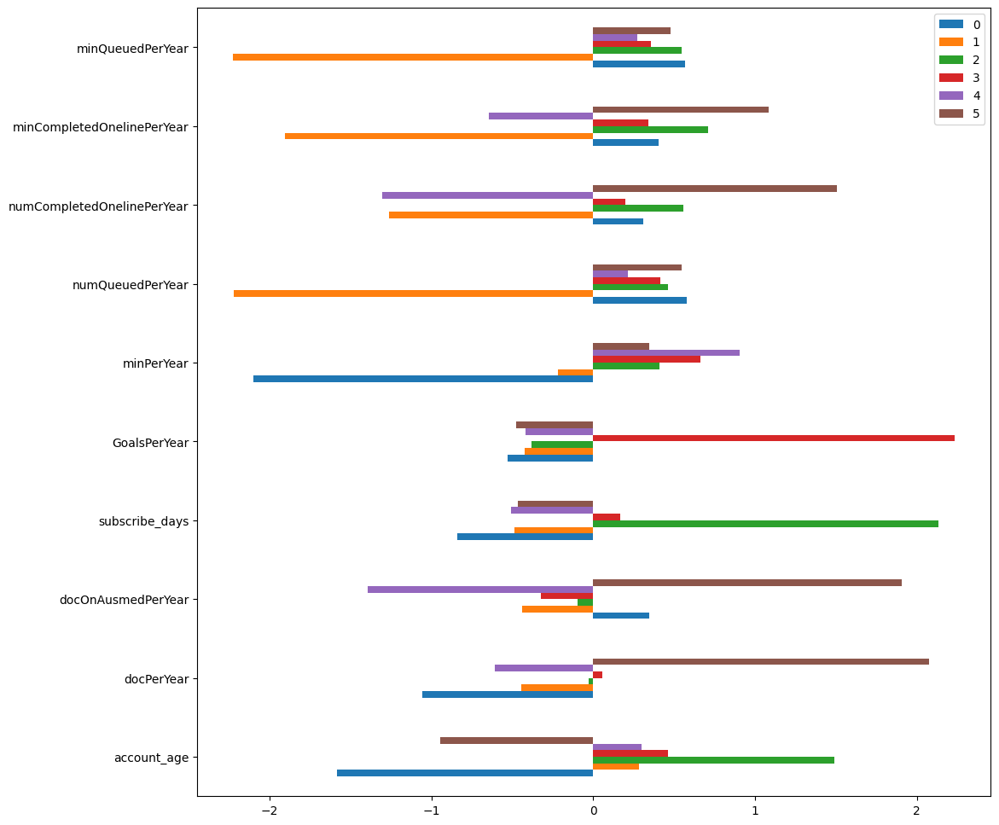

In [39]:
fig, ax = plt.subplots(figsize = (12, 12))

df_interest.T.plot(kind = 'barh', ax = ax);

# plt.savefig('feature_comparison.png', facecolor = 'white')

## interpretation (kind of struggled here because idk exactly what some of the features mean)

### these don't align with the graphs above, I re-ran the notebook and the cluster ordering changed, so just use this as an example haha

cluster 0 = long time subscriber, low minperyear, low docperyear

cluster 1 =  quite new, low docs, low completed

cluster 2 = long time subscribers

cluster 3 = high online completed per year and docs

cluster 4 = low completed & queued

cluster 5 = new account, low min per year, high event_cpd_day

## Save data w cluster ids & save pipeline

In [40]:
# combine original data with cluster labels
df_clean['cluster_id'] = fitted_kmeans.labels_

In [41]:
#df_clean.to_csv('clean_data_w_cluster_labels.csv')

In [42]:
import joblib
joblib.dump(full_pipe, 'pipeline_12pc_6kmeans.joblib')

['pipeline_12pc_6kmeans.joblib']

## load pipeline

In [ ]:
load_pipe = joblib.load('pipeline_12pc_6kmeans.joblib')

In [ ]:
load_pipe.predict(df_clean)